In [1]:
# Packages
import scanpy as sc
import squidpy as sq
import numpy as np
import seaborn as sns
import pandas as pd
import cell2location as c2l
import matplotlib
import os
import scipy
import scipy.sparse
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import warnings

# Suppress Pandas and Squidpy warnings
pd.options.mode.chained_assignment = None
warnings.filterwarnings("ignore", category=UserWarning, module='squidpy')

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
2024-08-11 12:40:49.812009: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
sc.settings.figdir = '/project/data/gew123/Spatial/Figures/squidpy'
sc.set_figure_params(dpi=100, dpi_save=400, figsize=(6,6))

In [40]:
# Read in spatial object
adata = sc.read_h5ad('/project/data/gew123/Spatial/Annotated_objects/spatial_annotated_final.h5ad')

### Neighborhood analysis

In [28]:
# Get df
df = adata.obs
coord = np.array([df['CenterX_global_px'], df['CenterY_global_px']])
coord = np.transpose(coord)
coord

adata.obsm = {'spatial': coord, 'X_pca' : adata.obsm["X_pca"], "X_umap" : adata.obsm["X_umap"]}
adata

# Creates a graph from spatial coordinates
sq.gr.spatial_neighbors(adata)

# Compute neighbourhood enrichment by permutation test
# Returns a z-score and enrichment count
sq.gr.nhood_enrichment(adata, cluster_key="broad_annotations")

  0%|          | 0/1000 [00:00<?, ?/s]

{'zscore': array([[ 1.26559546e+01,  2.25885902e+01, -1.18769268e+01,
          2.10209367e+00,  4.13810671e+00, -2.69638384e+00,
         -1.19502420e+01,  7.57066903e+00, -1.74126514e+01,
         -1.10896731e+01, -5.44074139e+00,  1.31348964e+01],
        [ 2.23066095e+01,  4.59097077e+01, -1.76671781e+01,
         -9.44727043e-01,  3.40093869e+00, -5.29374736e+00,
         -8.02864321e+00,  2.01632416e+01, -1.97574365e+01,
         -1.53835835e+01, -9.24222148e+00,  4.09647561e+01],
        [-1.24470076e+01, -1.78349165e+01,  9.93738240e+01,
          3.22966320e+01,  1.72238138e+01, -2.81074616e+01,
         -4.16045872e+01, -4.34447677e+01, -4.19502568e+01,
          7.08885482e+01, -3.55048797e+01, -1.98595565e+01],
        [ 2.26036700e+00, -1.99466838e+00,  3.14475208e+01,
          2.93269727e+01,  1.61534864e+01, -1.51472567e+01,
         -3.04221050e+01, -1.67349375e+01, -3.32425091e+01,
          4.06710145e+01, -2.25704608e+01, -1.31752388e+01],
        [ 4.68983095e+00, 

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


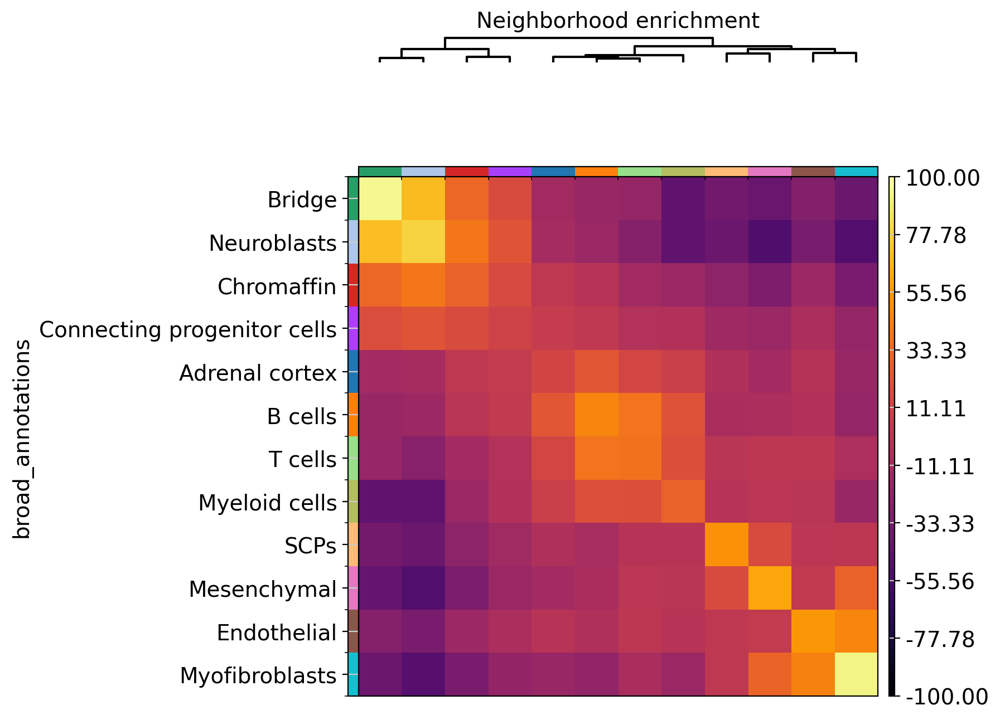

In [78]:
# plots neighbourhood enrichment
# plots the zscore
# uses average linkage method for clustering of dendrogram so you can see nice square clusters
sq.pl.nhood_enrichment(adata, cluster_key="broad_annotations", method="average",
                       figsize=(6, 6), vmin=-100, vmax=100, cmap="inferno", save='squidpy_neighborhoods_heatmap.png')

In [30]:
# Subset adata
immune_types = ['Mast cells', 'Macrophages/monocytes',
                'B cells', 'Plasma cells',
                'Helper (CD4+) T cells', 'NK cells', 'Cytotoxic (CD8+) T cells', 'Naïve T cells', 
                ]
adata_immune = adata[adata.obs['fine_annotations'].isin(immune_types)].copy()

In [31]:
# Neighborhood enrichment for fine immune annotations only

df = adata_immune.obs
coord = np.array([df['CenterX_global_px'], df['CenterY_global_px']])
coord = np.transpose(coord)
coord

adata_immune.obsm = {'spatial': coord, 'X_pca' : adata_immune.obsm["X_pca"], "X_umap" : adata_immune.obsm["X_umap"]}
adata_immune

# Creates a graph from spatial coordinates
sq.gr.spatial_neighbors(adata_immune)

# Compute neighbourhood enrichment by permutation test
# Returns a z-score and enrichment count
sq.gr.nhood_enrichment(adata_immune, cluster_key="fine_annotations")

  0%|          | 0/1000 [00:00<?, ?/s]

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


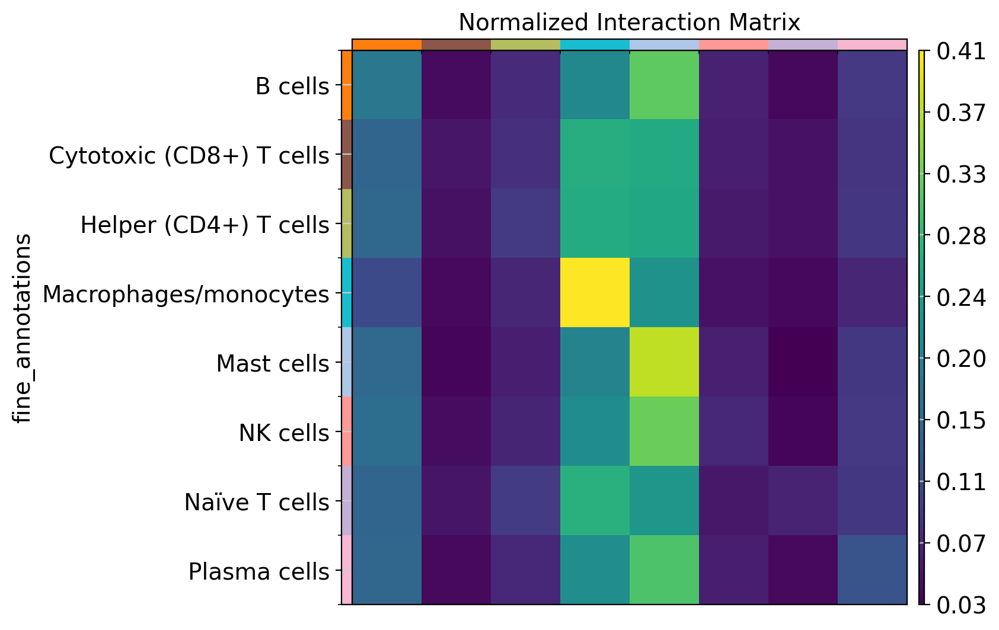

In [36]:
sq.gr.interaction_matrix(adata_immune, cluster_key="fine_annotations", normalized = True)
sq.pl.interaction_matrix(adata_immune, cluster_key="fine_annotations", title='Normalized Interaction Matrix')#, save='squidpy_interaction_matrix.png')

### Ripley's function

ERROR: Unable to fetch palette, reason: 'broad_annotations_colors'. Using `None`.


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/squidpy/pl/_graph.py:317: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(y="stats", x="bins", ci="sd", alpha=0.01, color="gray", data=res["sims_stat"], ax=ax)


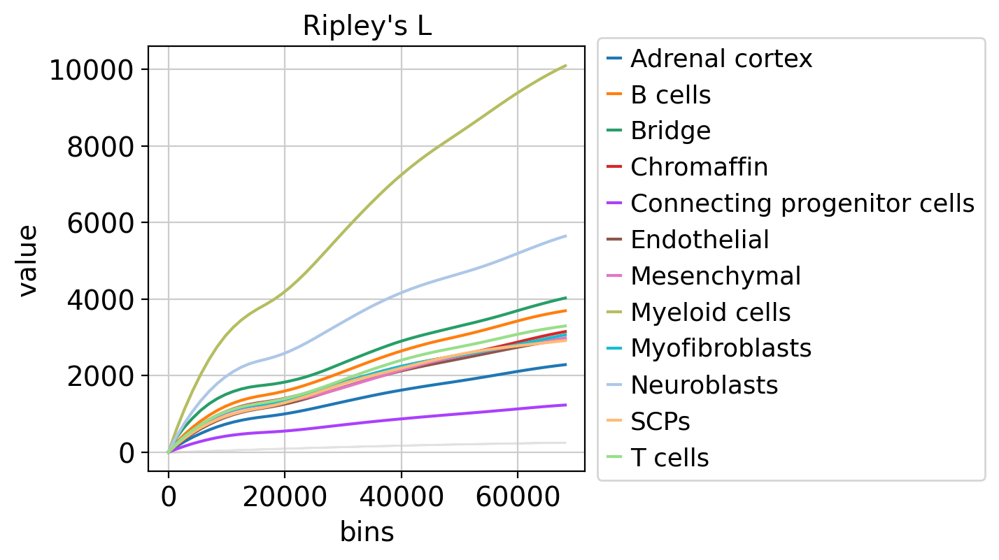

In [17]:
mode = "L"
sq.gr.ripley(adata, cluster_key="broad_annotations", mode=mode)
sq.pl.ripley(adata, cluster_key="broad_annotations", mode=mode)

### Interaction matrix

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


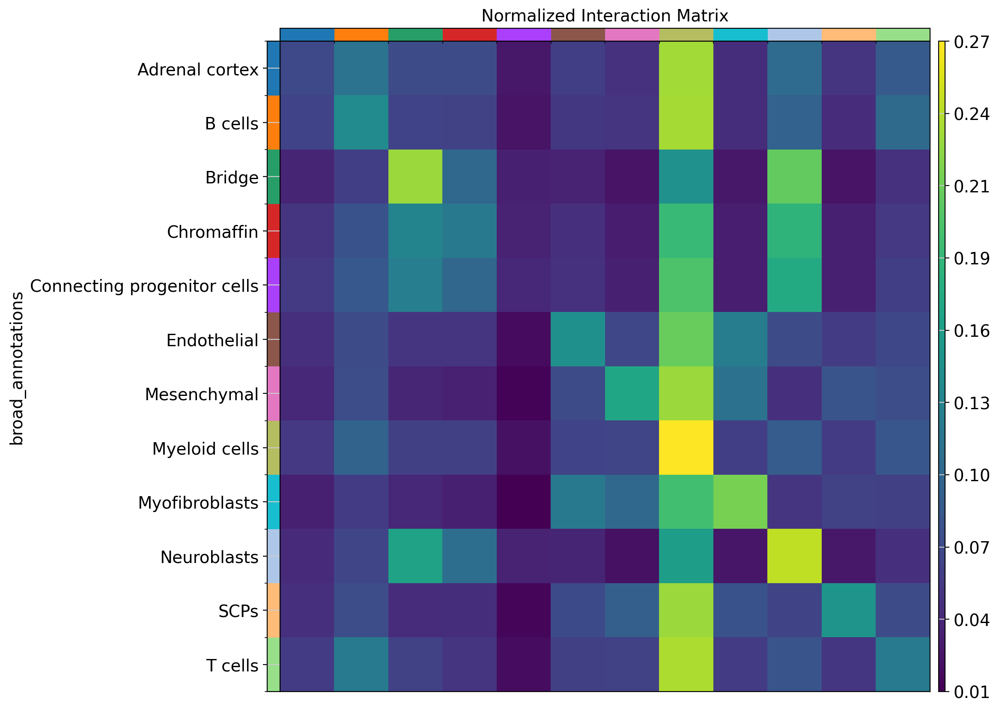

In [16]:
sq.gr.interaction_matrix(adata, cluster_key="broad_annotations", normalized = True)
sq.pl.interaction_matrix(adata, cluster_key="broad_annotations", title='Normalized Interaction Matrix', save='squidpy_interaction_matrix.png')

### Moran's I scores

Calculate for each tissue

In [14]:
moran_scores = {}

for tissue in adata.obs['tissue'].unique():
    # Subset to single tissue
    tissue_subset = adata[adata.obs['tissue']==tissue]
    # Calculate spatial neighborhoods graph
    sq.gr.spatial_neighbors(tissue_subset)
    # Calculate autocorrelation
    sq.gr.spatial_autocorr(tissue_subset, mode="moran", genes=tissue_subset.var_names)
    # Store top 5 genes
    df = tissue_subset.uns['moranI'].head()
    df['tissue'] = tissue
    # Store in dict
    moran_scores[tissue] = df
    # Print
    print(tissue, 'SVGs :', df.index.tolist())

tissue_01 SVGs : ['APOE', 'MALAT1', 'CCL21', 'HMGN2', 'MEG3']
tissue_02 SVGs : ['APOD', 'IGFBP7', 'MYH11', 'TAGLN', 'ACTA2']
tissue_03 SVGs : ['IGFBP7', 'CCND1', 'TAGLN', 'MGP', 'COL3A1']
tissue_04 SVGs : ['HSPA1A.B', 'CLU', 'MALAT1', 'IGFBP7', 'APOE']
tissue_05 SVGs : ['CCND1', 'CD74', 'RGS5', 'APOE', 'IGFBP7']
tissue_06 SVGs : ['APOD', 'VIM', 'MALAT1', 'MHC.I', 'APOE']
tissue_07 SVGs : ['IL1B', 'KRT19', 'IGHG2', 'HSPA1A.B', 'IGKC']
tissue_08 SVGs : ['BASP1', 'CLU', 'PSAP', 'MALAT1', 'HSP90AB1']
tissue_09 SVGs : ['SST', 'RAMP1', 'SPOCK2', 'CLU', 'HSP90AB1']
tissue_10 SVGs : ['BASP1', 'PSAP', 'HSP90AB1', 'CALM2', 'MALAT1']
tissue_11 SVGs : ['B2M', 'HSPA1A.B', 'HSPB1', 'IGFBP7', 'MALAT1']
tissue_12 SVGs : ['STMN1', 'H4C3', 'CCND1', 'PPIA', 'MGP']
tissue_13 SVGs : ['CLU', 'KRT19', 'RAMP1', 'SPOCK2', 'BASP1']


In [ ]:
# Save 
merged_df = pd.concat(moran_scores.values())
# Make gene names a column
merged_df.index.name = 'gene'
merged_df.reset_index(inplace=True)
merged_df
merged_df.to_csv('/project/data/gew123/Spatial/SVGs/moran_scores.csv', index=False)

In [37]:
svg_df = pd.read_csv('/project/data/gew123/Spatial/SVGs/moran_scores.csv')
svg_df

,gene,I,pval_norm,var_norm,pval_norm_fdr_bh,tissue
0,APOE,0.281976,0.0,0.000025,0.0,tissue_01
1,MALAT1,0.279415,0.0,0.000025,0.0,tissue_01
2,CCL21,0.270281,0.0,0.000025,0.0,tissue_01
3,HMGN2,0.267412,0.0,0.000025,0.0,tissue_01
4,MEG3,0.263909,0.0,0.000025,0.0,tissue_01
...,...,...,...,...,...,...
60,CLU,0.229002,0.0,0.000077,0.0,tissue_13
61,KRT19,0.215167,0.0,0.000077,0.0,tissue_13
62,RAMP1,0.199206,0.0,0.000077,0.0,tissue_13
63,SPOCK2,0.166768,0.0,0.000077,0.0,tissue_13


In [38]:
# Get top svgs per tissue
svg_dict = {}

for tissue in svg_df['tissue'].unique():
    curr_genes = svg_df[svg_df['tissue'] == tissue].reset_index()
    svg_dict[tissue] = curr_genes['gene'][0]
svg_dict

{'tissue_01': 'APOE',
 'tissue_02': 'APOD',
 'tissue_03': 'IGFBP7',
 'tissue_04': 'HSPA1A.B',
 'tissue_05': 'CCND1',
 'tissue_06': 'APOD',
 'tissue_07': 'IL1B',
 'tissue_08': 'BASP1',
 'tissue_09': 'SST',
 'tissue_10': 'BASP1',
 'tissue_11': 'B2M',
 'tissue_12': 'STMN1',
 'tissue_13': 'CLU'}

Calculate with log-norm counts

In [32]:
moran_scores = {}

for tissue in adata.obs['tissue'].unique():
    # Subset to single tissue
    tissue_subset = adata[adata.obs['tissue']==tissue]
    # Calculate spatial neighborhoods graph
    sq.gr.spatial_neighbors(tissue_subset)
    # Calculate autocorrelation
    sq.gr.spatial_autocorr(tissue_subset, mode="moran", genes=tissue_subset.var_names)
    # Store top 5 genes
    df = tissue_subset.uns['moranI'].head()
    df['tissue'] = tissue
    # Store in dict
    moran_scores[tissue] = df
    # Print
    print(tissue, 'SVGs :', df.index.tolist())

tissue_01 SVGs : ['APOE', 'CCL21', 'MEG3', 'THBS1', 'MGP']
tissue_02 SVGs : ['APOD', 'MYH11', 'TAGLN', 'ACTA2', 'IGFBP7']
tissue_03 SVGs : ['IGFBP7', 'TAGLN', 'CCND1', 'MGP', 'COL3A1']
tissue_04 SVGs : ['HSPA1A.B', 'CLU', 'SST', 'MALAT1', 'APOE']
tissue_05 SVGs : ['IGFBP7', 'CD74', 'APOE', 'VIM', 'TAGLN']
tissue_06 SVGs : ['APOD', 'VIM', 'APOE', 'MHC.I', 'MALAT1']
tissue_07 SVGs : ['IL1B', 'IGHG2', 'KRT19', 'IGKC', 'IGHG1']
tissue_08 SVGs : ['BASP1', 'IGFBP7', 'FOS', 'VIM', 'CLU']
tissue_09 SVGs : ['SST', 'RAMP1', 'SPOCK2', 'CLU', 'CD74']
tissue_10 SVGs : ['BASP1', 'IGFBP7', 'SOX4', 'HSP90AB1', 'PSAP']
tissue_11 SVGs : ['B2M', 'IGFBP7', 'COL4A2', 'COL4A1', 'HSPB1']
tissue_12 SVGs : ['MGP', 'STMN1', 'APOE', 'H4C3', 'CCND1']
tissue_13 SVGs : ['KRT19', 'CLU', 'RAMP1', 'SPOCK2', 'RGS5']


In [33]:
# Save 
merged_df_norm = pd.concat(moran_scores.values())
# Make gene names a column
merged_df_norm.index.name = 'gene'
merged_df_norm.reset_index(inplace=True)
merged_df_norm
merged_df_norm.to_csv('/project/data/gew123/Spatial/SVGs/moran_scores_normalized.csv', index=False)

In [34]:
svg_df = pd.read_csv('/project/data/gew123/Spatial/SVGs/moran_scores_normalized.csv')
svg_df

,gene,I,pval_norm,var_norm,pval_norm_fdr_bh,tissue
0,APOE,0.243082,0.0,0.000025,0.0,tissue_01
1,CCL21,0.235677,0.0,0.000025,0.0,tissue_01
2,MEG3,0.219898,0.0,0.000025,0.0,tissue_01
3,THBS1,0.219405,0.0,0.000025,0.0,tissue_01
4,MGP,0.213887,0.0,0.000025,0.0,tissue_01
...,...,...,...,...,...,...
60,KRT19,0.157759,0.0,0.000077,0.0,tissue_13
61,CLU,0.157671,0.0,0.000077,0.0,tissue_13
62,RAMP1,0.139161,0.0,0.000077,0.0,tissue_13
63,SPOCK2,0.115259,0.0,0.000077,0.0,tissue_13


In [35]:
# Get top svgs per tissue
svg_dict = {}

for tissue in svg_df['tissue'].unique():
    curr_genes = svg_df[svg_df['tissue'] == tissue].reset_index()
    svg_dict[tissue] = curr_genes['gene'][0]
svg_dict

{'tissue_01': 'APOE',
 'tissue_02': 'APOD',
 'tissue_03': 'IGFBP7',
 'tissue_04': 'HSPA1A.B',
 'tissue_05': 'IGFBP7',
 'tissue_06': 'APOD',
 'tissue_07': 'IL1B',
 'tissue_08': 'BASP1',
 'tissue_09': 'SST',
 'tissue_10': 'BASP1',
 'tissue_11': 'B2M',
 'tissue_12': 'MGP',
 'tissue_13': 'KRT19'}

tissue_01 , top SVG: APOE
tissue_03 , top SVG: IGFBP7
tissue_05 , top SVG: CCND1
tissue_08 , top SVG: BASP1


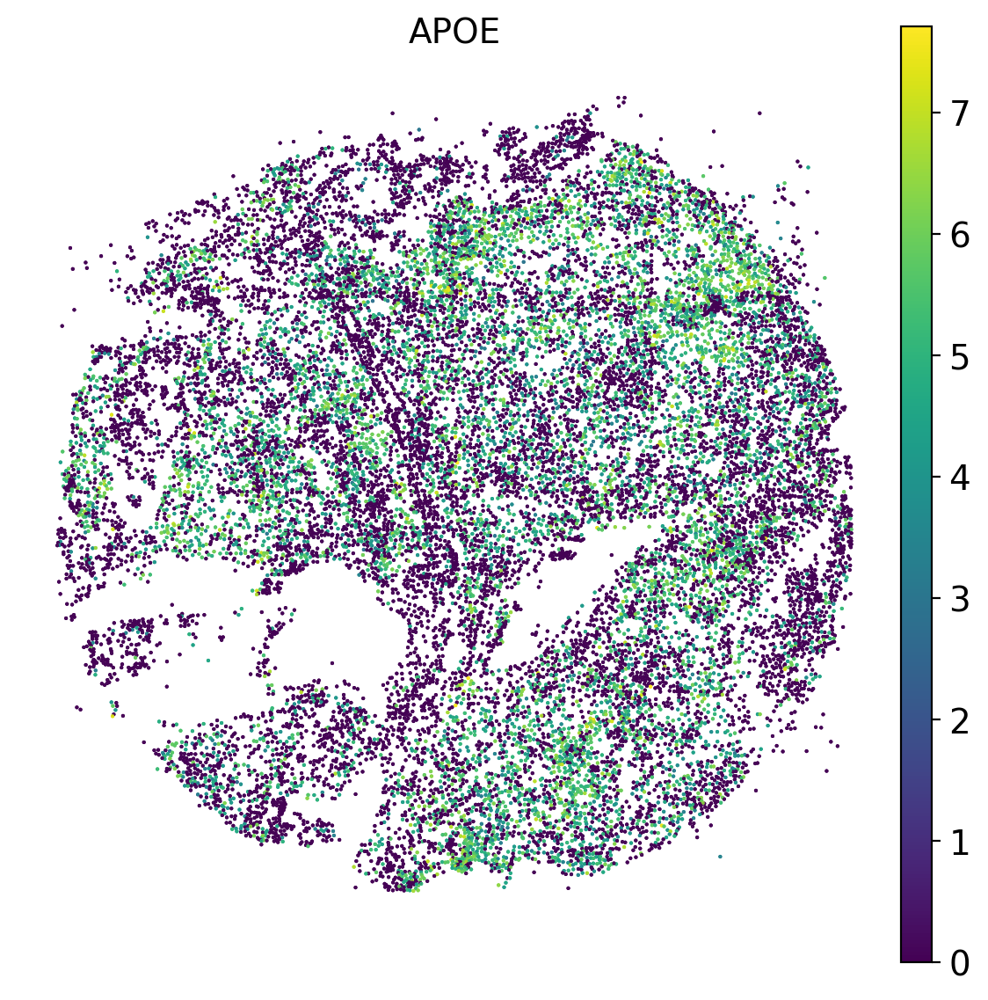

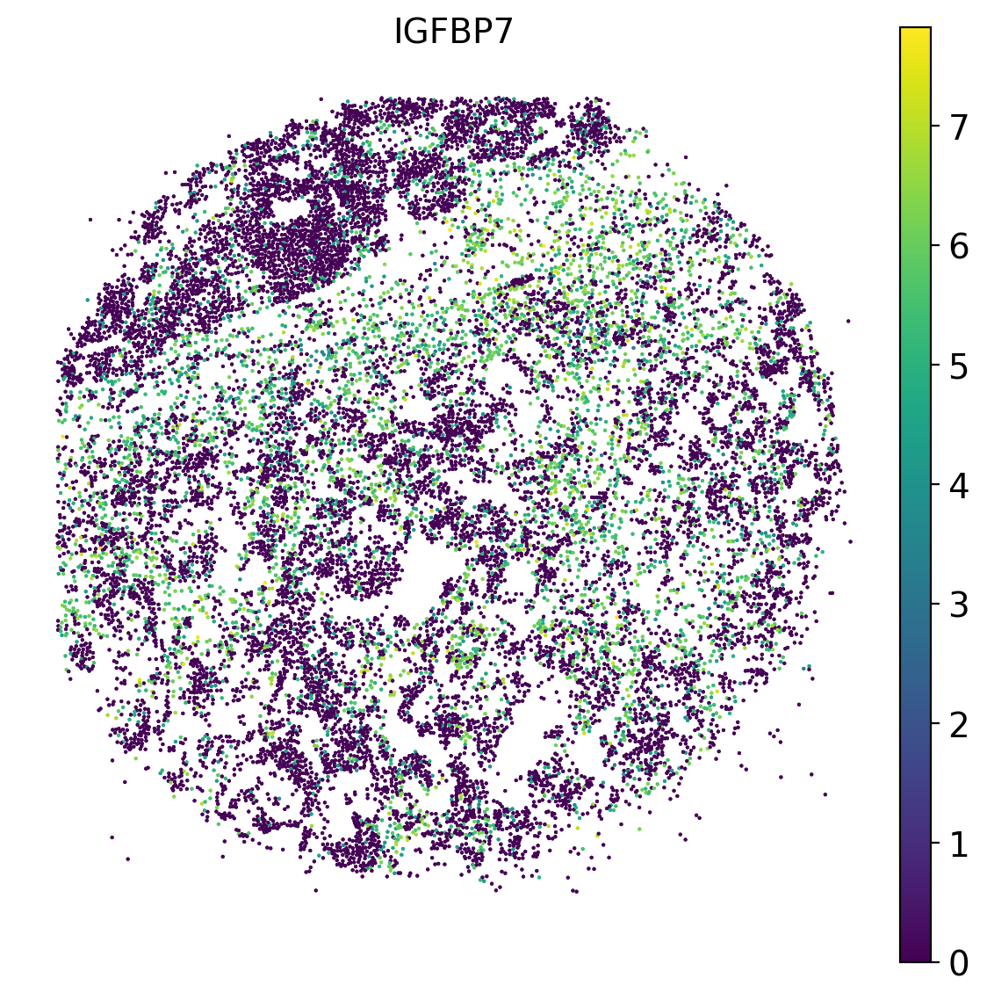

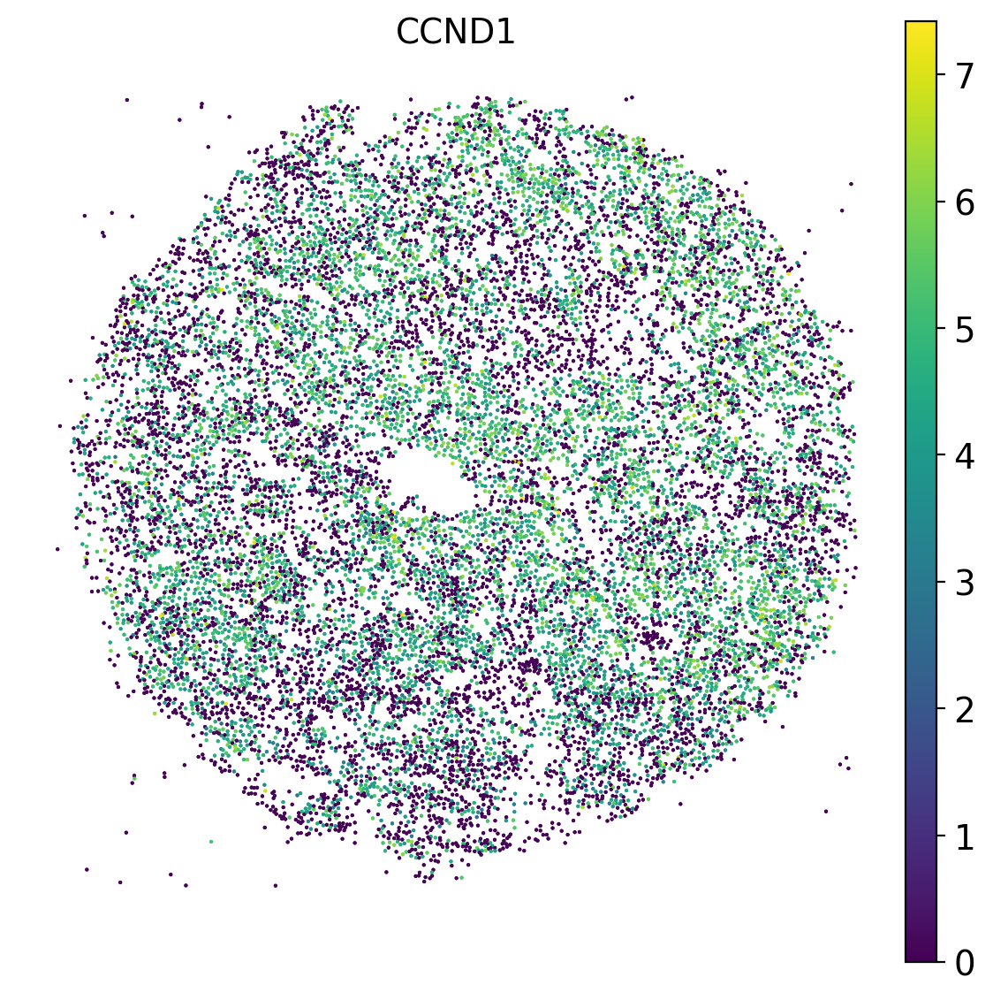

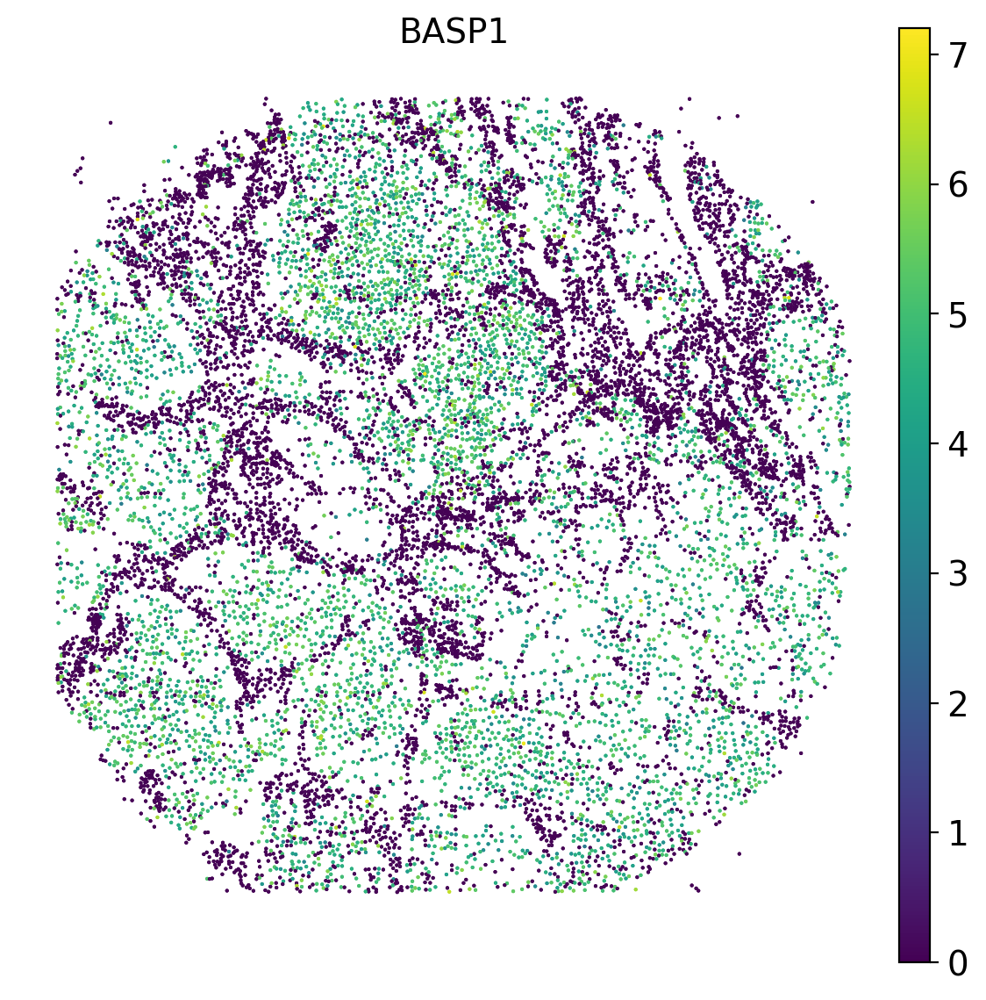

In [41]:
sc.set_figure_params(dpi=100, dpi_save=400, figsize=(7,7))
sc.settings.figdir = '/project/data/gew123/Spatial/Figures/svgs'

tissues_to_plot = ['tissue_01', 'tissue_03', 'tissue_08', 'tissue_05']

for tissue, top_svg in svg_dict.items():
    if tissue in tissues_to_plot:
        print(tissue, ', top SVG:', top_svg)
        tissue_subset = adata[adata.obs['tissue']==tissue]
        
        fig, ax = plt.subplots(figsize=(7,7))
        sq.pl.spatial_scatter(tissue_subset, shape=None, frameon=False, color=top_svg, size=1, figsize=(5,5), cmap='viridis', ax=ax)
        ax.invert_yaxis()
        plt.savefig(f'/project/data/gew123/Spatial/Figures/svgs/svg_{tissue}.png')


In [29]:
adata.X = adata.layers['log_counts']

Top SVGs for  tissue_01
Top SVGs for  tissue_03
Top SVGs for  tissue_05
Top SVGs for  tissue_08


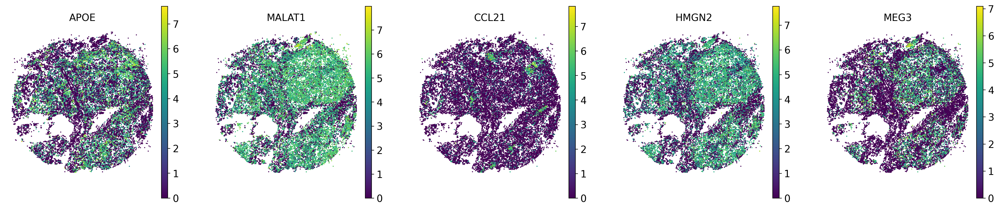

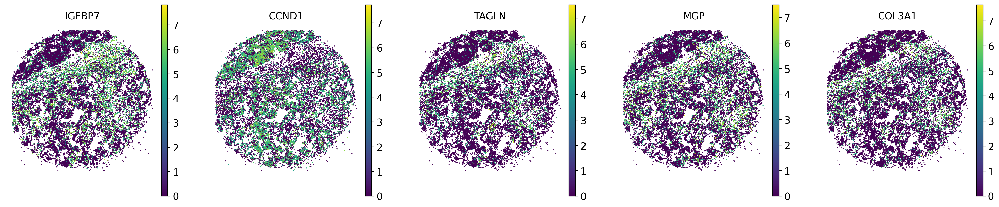

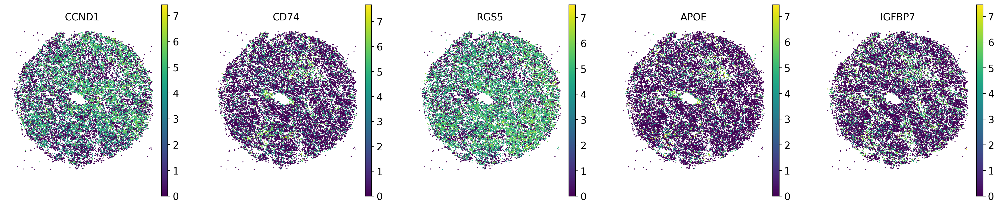

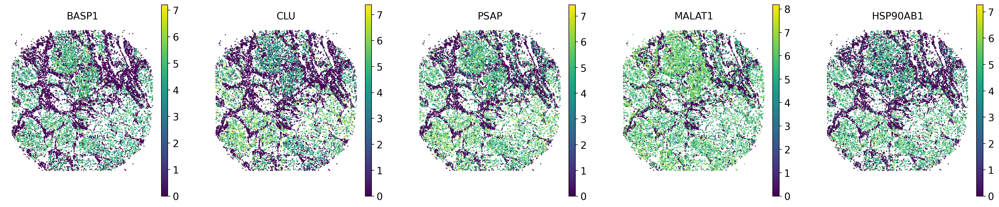

In [61]:
# Plot top 5 SVGs for a single tissue
def plot_top_svgs(adata, svg_df, tissue):
    print('Top SVGs for ', tissue)
    tissue_svgs = svg_df[svg_df['tissue'] == tissue].reset_index()
    genes_to_plot = [i for i in tissue_svgs['gene']]
    tissue_subset = adata[adata.obs['tissue']==tissue]

    # Plot
    fig, axes = plt.subplots(1, 5, figsize=(5 * 5, 5), sharex=True, sharey=True)

    for ax, gene in zip(axes, genes_to_plot):
        sq.pl.spatial_scatter(
            tissue_subset,
            shape=None,
            frameon=False,
            cmap='viridis',
            color=gene,
            size=0.8,
            ax=ax
        )
        # Properly orient the plot
        ax.invert_yaxis() 
    
    # Save
    plt.savefig(f'/project/data/gew123/Spatial/Figures/svgs/{tissue}_top_svgs_viridis.png')

# Plot for 4 different tissues tissues
plot_top_svgs(adata, svg_df, 'tissue_01')
plot_top_svgs(adata, svg_df, 'tissue_03')
plot_top_svgs(adata, svg_df, 'tissue_05')
plot_top_svgs(adata, svg_df, 'tissue_08')

In [8]:
# Rename cat annotations
adata.obs['cat_annotations'] = adata.obs['cat_annotations'].replace('Sympathoadrenal', 'ADRN')
adata.obs['cat_annotations'] = adata.obs['cat_annotations'].replace('Mesenchymal', 'MES')



/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


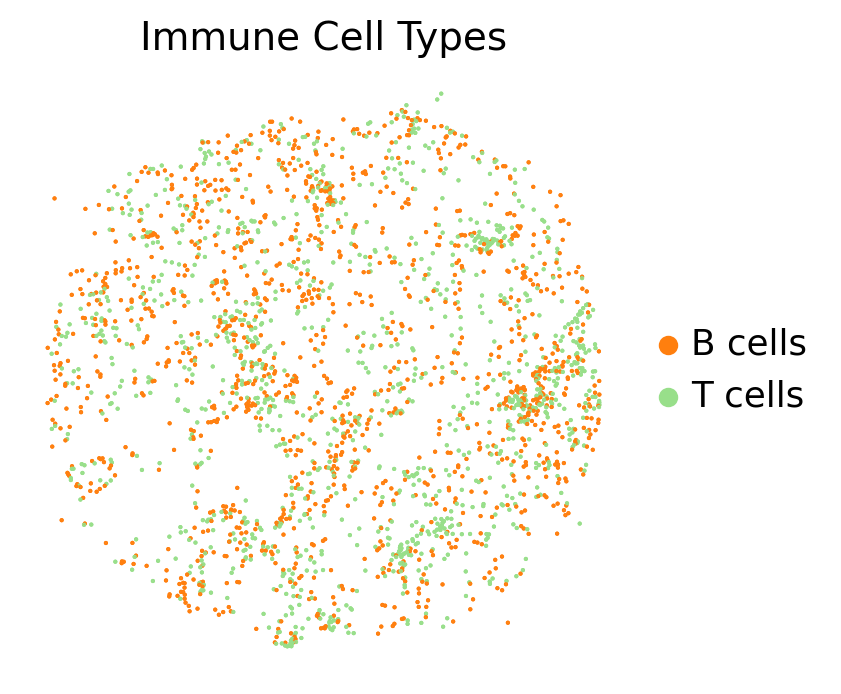

In [64]:
sc.set_figure_params(dpi=100, dpi_save=400, transparent=False)
sc.settings.figdir = '/project/data/gew123/Spatial/Figures/svgs'

tissue_subset = adata[adata.obs['tissue']=='tissue_01']
fig, ax = plt.subplots(figsize=(4,4))
sq.pl.spatial_scatter(tissue_subset, shape=None, frameon=False, color='broad_annotations', groups=['T cells', 'B cells'], 
                      size=1, figsize=(4,4), ax=ax,
                      title='Immune Cell Types', outline=False)
ax.invert_yaxis()
plt.savefig('/project/data/gew123/Spatial/Figures/svgs/tissue01_immune.png')

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


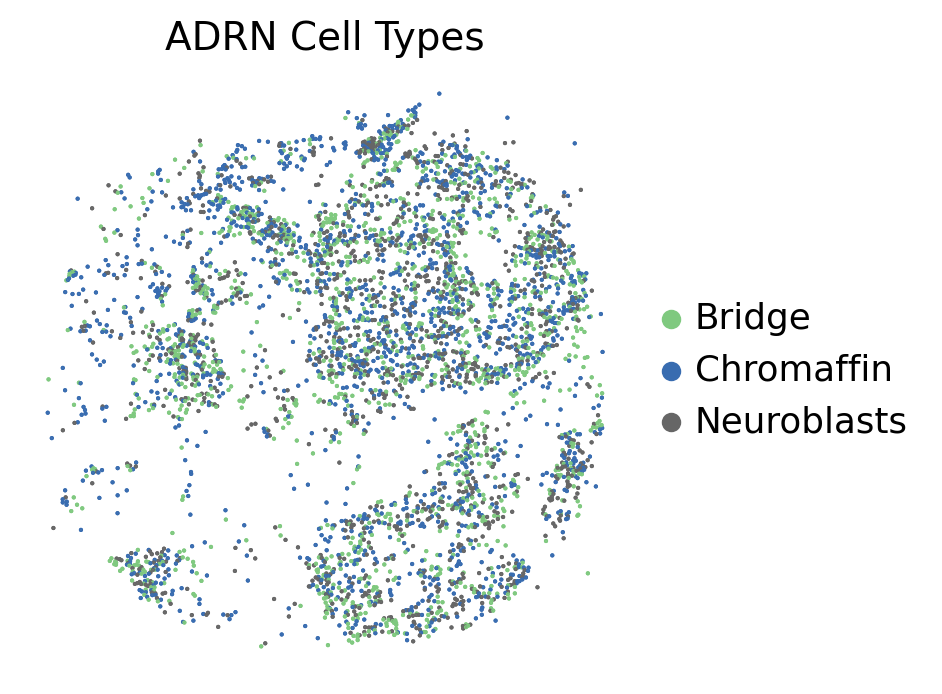

In [66]:
tissue_subset = adata[adata.obs['tissue']=='tissue_01']

# Using broad annotations
fig, ax = plt.subplots(figsize=(4,4))
sq.pl.spatial_scatter(tissue_subset, shape=None, frameon=False, color='broad_annotations', palette='Accent', groups=['Neuroblasts', 'Chromaffin', 'Bridge'], size=1, figsize=(5,5),
                      title='ADRN Cell Types', ax=ax)
ax.invert_yaxis()
plt.savefig('/project/data/gew123/Spatial/Figures/svgs/tissue01_ADRN.png')

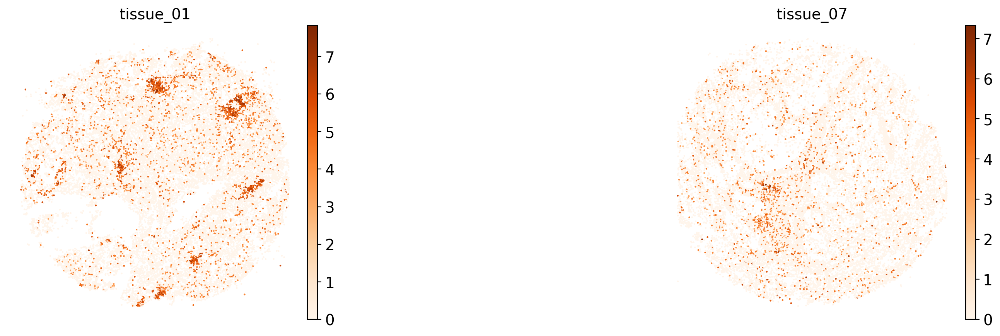

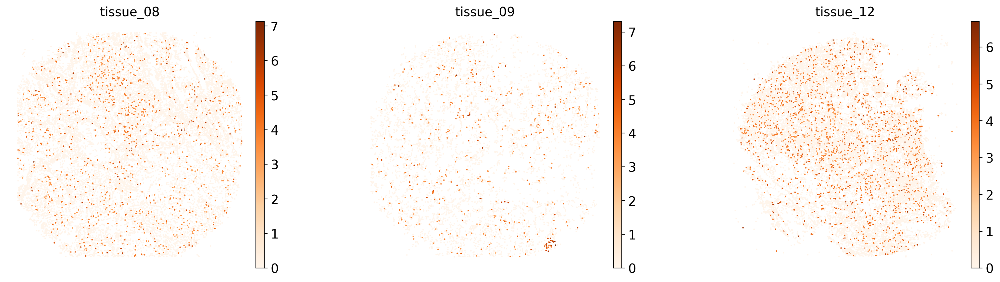

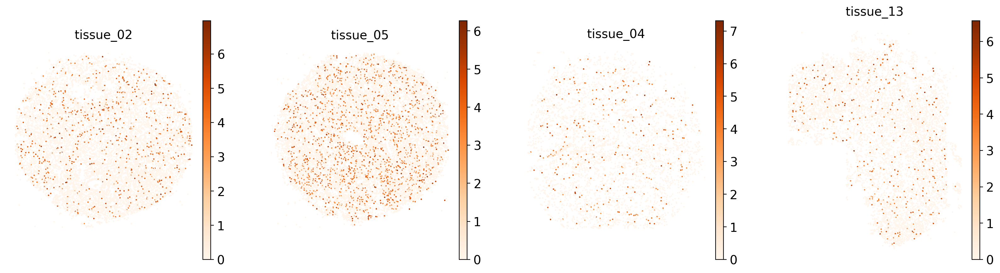

In [83]:
# Plotting CCL21 expression in later stage tumors
sc.set_figure_params(dpi=100, dpi_save=400, transparent=False)
sc.settings.figdir = '/project/data/gew123/Spatial/Figures/svgs'


def plot_spatial_expression(adata, tissues_to_plot, genes_to_plot, stage):
    fig, axs = plt.subplots(1, len(tissues_to_plot), figsize=(20,5))
    
    for index, tissue in enumerate(tissues_to_plot):
        tissue_subset = adata[adata.obs['tissue'] == tissue]
        sq.pl.spatial_scatter(
            tissue_subset,
            shape=None,
            frameon=False,
            ax=axs[index],
            cmap='Oranges',
            title=tissue,
            color=genes_to_plot,
            size=1,
        )
        axs[index].invert_yaxis()  # Invert the y-axis for each subplot
        plt.savefig(f'CCL21_expression_stage{stage}.png', dpi=400)
    

# Stage 1/2 tissues
stage_1_tissues = ['tissue_01', 'tissue_07']
# Stage 3 tissues
stage_3_tissues = ['tissue_08', 'tissue_09', 'tissue_12']
# Stage 4 tissues
stage_4_tissues = ['tissue_02', 'tissue_05', 'tissue_04', 'tissue_13']

plot_spatial_expression(adata, stage_1_tissues, 'CCL21', '1')
plot_spatial_expression(adata, stage_3_tissues, 'CCL21', '3')
plot_spatial_expression(adata, stage_4_tissues, 'CCL21', '4')

In [41]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,...,tissue,section,subtype,stage,cell_ID,fine_annotations,broad_annotations,cat_annotations,leiden_0.3,manual_labels
3_1,1,10996,2.06,95170.997899,99963.034702,183,89,52,4561,37,...,tissue_01,E4,differentiating neuroblastoma,1_2,3,Mast cells,Myeloid cells,Immune,5,Mixed cell types
5_1,1,9341,0.82,95468.997899,99760.034702,102,124,332,2770,341,...,tissue_01,E4,differentiating neuroblastoma,1_2,5,Endothelial cells,Endothelial,Endothelial,2,MES
6_1,1,4901,1.26,95379.997899,99721.034702,92,73,340,692,867,...,tissue_01,E4,differentiating neuroblastoma,1_2,6,Mesenchymal cells,Mesenchymal,Mesenchymal,2,MES
7_1,1,8042,0.76,95249.997899,99688.034702,93,123,380,1287,618,...,tissue_01,E4,differentiating neuroblastoma,1_2,7,Mast cells,Myeloid cells,Immune,6,Mixed cell types
8_1,1,3137,0.72,95412.997899,99681.034702,63,87,569,1201,915,...,tissue_01,E4,differentiating neuroblastoma,1_2,8,Endothelial cells,Endothelial,Endothelial,0,ADRN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471_202,202,4170,0.92,81967.003876,56219.283252,82,89,2288,14766,404,...,tissue_13,D3,neuroblastoma,4,471,Helper (CD4+) T cells,T cells,Immune,2,MES
473_202,202,4561,1.39,82186.003876,56182.283252,97,70,3171,17822,511,...,tissue_13,D3,neuroblastoma,4,473,Macrophages/monocytes,Myeloid cells,Immune,4,IMMUNE
474_202,202,6188,1.43,82094.003876,56138.283252,109,76,3346,16071,405,...,tissue_13,D3,neuroblastoma,4,474,Myofibroblasts,Myofibroblasts,Myofibroblasts,2,MES
475_202,202,4717,1.08,81896.003876,56118.283252,81,75,2092,13187,438,...,tissue_13,D3,neuroblastoma,4,475,SCPs,SCPs,SCPs,2,MES


TypeError: Palette is <class 'dict'> but should be string or `ListedColormap`.

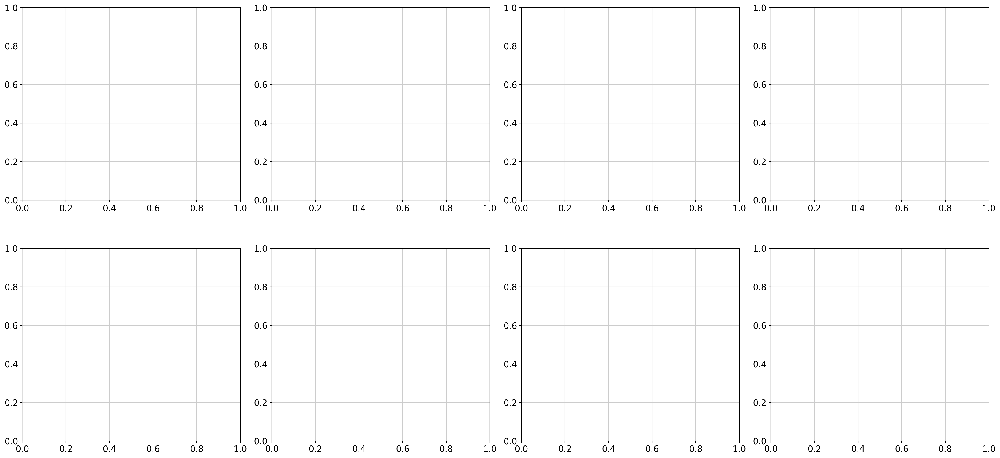

In [46]:
# Using colors from previous plot
# Colors
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
colors[8:9], colors[9:10] = colors[9:10], colors[8:9] # Swap myofibroblast and neuroblastoma colors (colors 8 and 9)
colors[1:2], colors[7:8] = colors[7:8], colors[1:2] # Swap b cells and myeloid colors (colors 1 and 7)
colors[11:12], colors[3:4] = colors[3:4], colors[11:12] # Swap chromaffin and scp colors (colors 2 and 11)
colors[11:12], colors[6:7] = colors[6:7], colors[11:12] # Swap neuroblast and plasma cell colors (colors 2 and 11)
colors[7:8], colors[11:12] = colors[11:12], colors[7:8]
colors[7:8], colors[10:11] = colors[10:11], colors[7:8] # Swap myeloid and plasma
colors[11:12], colors[7:8] = colors[7:8], colors[11:12] # Swap myeloid and t cells
colors[4:5], colors[10:11] = colors[10:11], colors[4:5] # Swap scps and connecting prog
colors[2:3], colors[3:4] = colors[3:4], colors[2:3] # Swap bridge and chromaffin
colors[5:6], colors[4:5] = colors[4:5], colors[5:6] # Swap endothelial and connecting prog

color_map = dict(zip(adata.obs['broad_annotations'].cat.categories, colors))
#colors = counts_df['Grouped Annotations'].map(color_map).tolist()
cmap = mcolors.ListedColormap(colors)

def get_fovs(start,end):
    return [str(i) for i in range(start, end+1)]

plt.rcParams['figure.figsize'] = [6, 6]
sq.pl.spatial_segment(
    adata,
    color="broad_annotations",
    palette=color_map,
    library_key="fov",
    library_id=get_fovs(117,124),
    seg_cell_id="cell_ID",
    seg_outline=True,
)